In [3]:
import numpy as np
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data

import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torch.autograd as autograd
from torch.autograd import Variable

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Seed control, for better reproducibility 
# NOTE: this does not gurantee results are always the same
seed = 22
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)

if torch.cuda.is_available():
    device = torch.device("cuda:0")
    # work on a single GPU or CPU
    cudnn.benchmark=True
    generator.cuda()
    discriminator.cuda()
    adversarial_loss.cuda()
    Tensor = torch.cuda.FloatTensor
else:
    device = torch.device("cpu")
    cudnn.benchmark=False
    Tensor = torch.FloatTensor

print(device)

EPOCHS = 500


cpu


In [4]:
def imshow(img):
    # custom show in order to display
    # torch tensors as numpy
    npimg = img.numpy() / 2 + 0.5 # from tensor to numpy
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

batch_size = 250 # might try to use large batches (we will discuss why later when we talk about BigGAN)
# NOTE: the batch_size should be an integer divisor of the data set size  or torch
# will give you an error regarding batch sizes of "0" when the data loader tries to
# load in the final batch

dataset = dset.CIFAR10(root='data/cifar/', download=True,
                       transform=transforms.Compose([
                           transforms.ToTensor(),
                           transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                       ]))

# frogs are the sixth class in the dataset 
classes = ['plane', 'car', 'bird', 'cat','deer', 'dog', 'frog', 'horse', 'ship', 'truck']
frog = 6
frog_index = [i for i, x in enumerate(dataset.targets) if x == 6]
print("number of frog imgs: ", len(frog_index))

frog_set = torch.utils.data.Subset(dataset, frog_index)


dataloader = torch.utils.data.DataLoader(frog_set, batch_size=batch_size,
                                         shuffle=True, num_workers=1)

0it [00:00, ?it/s]

100%|█████████▉| 170221568/170498071 [00:18<00:00, 25539218.75it/s]

Extracting data/cifar/cifar-10-python.tar.gz to data/cifar/
number of frog imgs:  5000


170500096it [00:30, 25539218.75it/s]                               

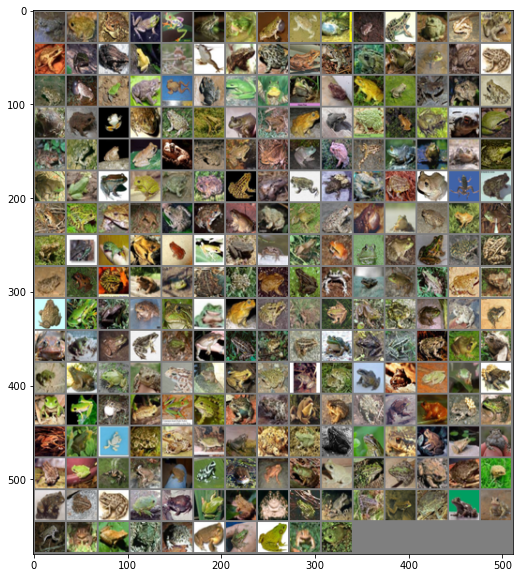

170500096it [00:51, 3317044.34it/s] 

Image shape:  torch.Size([3, 32, 32])


In [5]:
# get some random training images
dataiter = iter(dataloader)
real_image_examples, _ = dataiter.next()

# show images
plt.figure(figsize=(10,10))
imshow(torchvision.utils.make_grid(real_image_examples, nrow=int(np.sqrt(batch_size))))
print("Image shape: ", real_image_examples[0].size())


# Vanilla Generative Adversarial Networks
In this implementation of GANS, we will use a few of the tricks from F. Chollet and from Salimans et al. In particular, we will add some noise to the labels. 

In [9]:
latent_dim = 32
height = 32
width = 32
channels = 3

# Note: according to Radford (2016), is there anything done here
# that potentially could have been different? 
# Also: adda review of BatchNorm here. 

class Generator(nn.Module):

    def __init__(self):
        super(Generator, self).__init__()

        # First, transform the input into a 8x8 128-channels feature map
        self.init_size = width // 4 # one quarter the image size 
        self.l1 = nn.Sequential( nn.Linear(latent_dim, 128 * self.init_size ** 2) )
        # there is no reshape layer, this will be done in forward function
        # alternately we could us only the functional API
        # and bypass sequential altogether

        # we will use the sequential API
        # in order to create some blocks
        self.conv_blocks = nn.Sequential(
            nn.BatchNorm2d(128),
            nn.Upsample(scale_factor=2, mode='bilinear'), #16x16
            nn.Conv2d(128, 128, 3, padding=1), #16x16

            # Then, add a convolution layer
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            # Upsample to 32x32
            nn.Upsample(scale_factor=2, mode='bilinear'), # 32x32
            nn.ConvTranspose2d(128, 64, 3, padding=1),
            nn.BatchNorm2d(64, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            # Produce a 32x32xRGB-channel feature map
            nn.Conv2d(64, channels, kernel_size=3, padding=1),
            nn.Tanh(),
        )

    def forward(self, z):
        # expand the sampled z to 8x8
        out = self.l1(z)
        out = torch.reshape(out, (out.shape[0], 128, self.init_size, self.init_size))
        # use the view function to reshape the layer output
        #  old way for earlier Torch versions: out = out.view(out.shape[0], 128, self.init_size, self.init_size)
        img = self.conv_blocks(out)
        return img

In [10]:
class Discriminator(nn.Module):

    def __init__(self):
        super(Discriminator, self).__init__()

        self.model = nn.Sequential(
            nn.Conv2d(3, 16, 3, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            # dropout layer - important trick!
            nn.Dropout2d(0.25),

            nn.Conv2d(16, 32, 3, stride=2, padding=1),
            nn.LeakyReLU(0.3, inplace=True),
            nn.Dropout2d(0.25),
            nn.BatchNorm2d(32, 0.8),

            nn.Conv2d(32, 64, 3, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.25),
            nn.BatchNorm2d(64, 0.8),

            nn.Conv2d(64, 128, 3, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.25),
            nn.BatchNorm2d(128, 0.8),
        )

        # The height and width of downsampled image
        ds_size = width // 2 ** 4
        # Classification layer
        self.classification_layer = nn.Sequential(nn.Linear(128 * ds_size ** 2, 1), 
                                                  nn.Sigmoid())

    def forward(self, img):
        out = self.model(img)
        # use the view function to flatten the layer output
        #    old way for earlier Torch versions: out = out.view(out.shape[0], -1)
        out = torch.flatten(out, start_dim=1) # don't flatten over batch size
        validity = self.classification_layer(out)
        return validity

In [11]:
# custom weights initialization called on netG and netD
# this function from PyTorch's officail DCGAN example:
# https://github.com/pytorch/examples/blob/master/dcgan/main.py#L112
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02) # filters are zero mean, small STDev
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02) # batch norm is unit mean, small STDev
        m.bias.data.fill_(0) # like normal, biases start at zero

In [12]:
generator = Generator()
discriminator = Discriminator()

In [13]:
# To stabilize training, we use learning rate decay
# and gradient clipping (by value) in the optimizer.
clip_value = 1.0 # This value will use in the future training process since 
                 # PyTorch didn't has the feature to set clipvalue for 
                 # RMSprop optimizer.
# set discriminator learning higher than generator
discriminator_optimizer = torch.optim.RMSprop(discriminator.parameters(), 
                                              lr=0.0008, weight_decay=1e-8)

gan_optimizer = torch.optim.RMSprop(generator.parameters(), lr=0.0004, weight_decay=1e-8)

adversarial_loss = torch.nn.BCELoss() # binary cross entropy 


In [14]:
generator.apply(weights_init)
discriminator.apply(weights_init)

Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Dropout2d(p=0.25, inplace=False)
    (3): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): LeakyReLU(negative_slope=0.3, inplace=True)
    (5): Dropout2d(p=0.25, inplace=False)
    (6): BatchNorm2d(32, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (7): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Dropout2d(p=0.25, inplace=False)
    (10): BatchNorm2d(64, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (11): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (12): LeakyReLU(negative_slope=0.2, inplace=True)
    (13): Dropout2d(p=0.25, inplace=False)
    (14): BatchNorm2d(128, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
  )
  (classifi

In [15]:
iterations = EPOCHS

# Sample random points in the latent space
plot_num_examples = 25
fixed_random_latent_vectors = torch.randn(plot_num_examples, latent_dim, device=device)
img_list = []
total_steps = 0

real_image_numpy = np.transpose(torchvision.utils.make_grid(real_image_examples[:plot_num_examples,:,:,:], padding=2, normalize=False, nrow=5),(0,1,2))

In [11]:
%%time

# TODO: optionally load the checkpoint data here from previous run

# Start training loop
for step in range(iterations):
    total_steps = total_steps+1

    for i, (imgs, _) in enumerate(dataloader):

        #===================================
        # GENERATOR OPTIMIZE AND GET LABELS
        
        # Zero out any previous calculated gradients
        gan_optimizer.zero_grad()

        # Sample random points in the latent space
        random_latent_vectors = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim))))

        # Decode them to fake images, through the generator
        generated_images = generator(random_latent_vectors)

        # Assemble labels that say "all real images"
        misleading_targets = Variable(Tensor(imgs.shape[0], 1).fill_(1.0), requires_grad=False)

        # Get BCE Loss function
        # E[log d(x_fake)]
        # want generator output to generate images that are "close" to all "ones" 
        g_loss = adversarial_loss(discriminator(generated_images), misleading_targets)

        # now back propagate to get derivatives
        g_loss.backward()
        
        # use gan optimizer to only update the parameters of the generator
        # this was setup above to only use the params of generator
        gan_optimizer.step()
        
        #===================================
        # DISCRIMINATOR OPTIMIZE AND GET LABELS

        # Zero out any previous calculated gradients
        discriminator_optimizer.zero_grad()

        # Combine real images with some generator images
        real_images = Variable(imgs.type(Tensor))
        combined_images = torch.cat([real_images, generated_images.detach()])
        # in the above line, we "detach" the generated images from the generator
        # this is to ensure that no needless gradients are calculated 
        # those parameters wouldn't be updated (becasue we already defined the optimized parameters)
        # but they would be calculated here, which wastes time.

        # Assemble labels discriminating real from fake images
        labels = torch.cat((
            Variable(Tensor(imgs.shape[0], 1).fill_(1.0), requires_grad=False),
            Variable(Tensor(imgs.shape[0], 1).fill_(0.0), requires_grad=False)
        ))
        # Add random noise to the labels - important trick!
        labels += 0.05 * torch.rand(labels.shape)

        # Setup Discriminator loss
        # this takes the average of BCE(real images labeled as real) + BCE(fake images labeled as fake)
        #  E[log d(x_real)] + E[log 1- d(x_fake)]
        d_loss = (
            adversarial_loss(discriminator(combined_images[:batch_size]), labels[:batch_size]) + \
            adversarial_loss(discriminator(combined_images[batch_size:]), labels[batch_size:])
            ) / 2

        # get gradients according to loss above
        d_loss.backward()
        # optimize the discriminator parameters to better classify images
        discriminator_optimizer.step()

        # Now Clip weights of discriminator (manually)
        for p in discriminator.parameters():
            p.data.clamp_(-clip_value, clip_value)
            
        #===================================
        
    # Occasionally save / plot
    if step % 10 == 0:
        # Print metrics
        print('Loss at step %s: D(z_c)=%s, D(G(z_mis))=%s' % (total_steps, d_loss.item(),g_loss.item()))
        # save images in a list for display later
        with torch.no_grad():
            fake_output = generator(fixed_random_latent_vectors).detach().cpu()
        img_list.append(torchvision.utils.make_grid(fake_output, padding=2, normalize=True, nrow=5))
        
        # in addition, save off a checkpoint of the current models and images
        ims = np.array([np.transpose(np.hstack((i,real_image_numpy)), (2,1,0)) for i in img_list])
        np.save('models/gan_models/vanilla_images.npy',ims)

        # save the state of the models (will need to recreate upon reloading)
        torch.save({'state_dict': generator.state_dict()}, 'models/gan_models/vanilla_gen.pth')
        torch.save({'state_dict': discriminator.state_dict()}, 'models/gan_models/vanilla_dis.pth')
        

/Users/ericlarson/opt/anaconda3/envs/mlenv2021/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


Loss at step 1: D(z_c)=0.6390590667724609, D(G(z_mis))=0.6314025521278381
Loss at step 11: D(z_c)=0.6982100605964661, D(G(z_mis))=0.6279720664024353
Loss at step 21: D(z_c)=0.7137861251831055, D(G(z_mis))=0.6510453224182129
Loss at step 31: D(z_c)=0.6936168670654297, D(G(z_mis))=0.6344101428985596
Loss at step 41: D(z_c)=0.6873511672019958, D(G(z_mis))=0.6630176901817322
Loss at step 51: D(z_c)=0.7234673500061035, D(G(z_mis))=0.6030287146568298
Loss at step 61: D(z_c)=0.6745731234550476, D(G(z_mis))=0.6478986740112305
Loss at step 71: D(z_c)=0.7010748386383057, D(G(z_mis))=0.6845511198043823
Loss at step 81: D(z_c)=0.6983008980751038, D(G(z_mis))=0.6263479590415955
Loss at step 91: D(z_c)=0.7023251056671143, D(G(z_mis))=0.6641501784324646
Loss at step 101: D(z_c)=0.689208984375, D(G(z_mis))=0.6761195063591003
Loss at step 111: D(z_c)=0.6887251734733582, D(G(z_mis))=0.6745609641075134
Loss at step 121: D(z_c)=0.6865994334220886, D(G(z_mis))=0.6533544063568115
Loss at step 131: D(z_c)=0.

In [12]:
# save off everything at the end (same as the checkpoint)
ims = np.array([np.transpose(np.hstack((i,real_image_numpy)), (2,1,0)) for i in img_list])
np.save('models/gan_models/vanilla_images.npy',ims)

# save the state of the models (will need to recreate upon reloading)
torch.save({'state_dict': generator.state_dict()}, 'models/gan_models/vanilla_gen.pth')
torch.save({'state_dict': discriminator.state_dict()}, 'models/gan_models/vanilla_dis.pth')


In [13]:
if True: # load all the models
    ims = np.load('models/gan_models/vanilla_images.npy')

    generator = Generator()
    discriminator = Discriminator()

    checkpoint = torch.load('models/gan_models/vanilla_gen.pth')
    generator.load_state_dict(checkpoint['state_dict'])

    checkpoint = torch.load('models/gan_models/vanilla_dis.pth')
    discriminator.load_state_dict(checkpoint['state_dict'])


NameError: name 'ims' is not defined

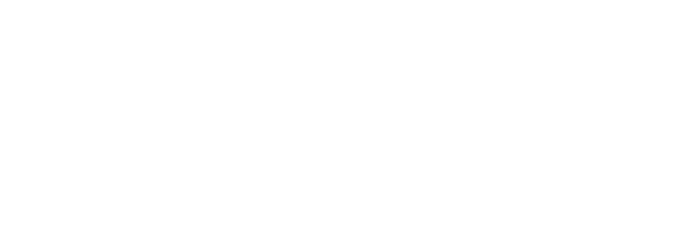

In [7]:
def norm_grid(im):
    # first half should be normalized and second half also, separately
    im = im.astype(np.float)
    rows,cols,chan = im.shape
    cols_over2 = int(cols/2)
    tmp = im[:,:cols_over2,:]
    im[:,:cols_over2,:] = (tmp-tmp.min())/(tmp.max()-tmp.min())
    tmp = im[:,cols_over2:,:]
    im[:,cols_over2:,:] = (tmp-tmp.min())/(tmp.max()-tmp.min())
    return im

      
fig = plt.figure(figsize=(12,4))
plt.axis("off")  
pls = [[plt.imshow(norm_grid(im), animated=True)] for im in ims]
ani = animation.ArtistAnimation(fig, pls, interval=500, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

We are getting something that is similar to a frog, but also we are seeing a bit of mode collapse. The global properties of a greenish or gray blob surrounded by various background is starting to comes across. However, the finer structure is not doing too well. That is, the legs and details in the background are not present yet. 

To improve this result, there are a number of things we might try such as:
- Adding more randomization to the optimizer
- Running the discriminator multiple times for each generator update
- Changing the objective function (let's try this one)

____
# Least Squares GAN
Actually, the only thing we need to do here is replace the adversarial loss function.

In [31]:
generator = Generator()
discriminator = Discriminator()


# LSGAN says they use ADAM, but follow up papers say RMSProp is lsightly better
#lr = 0.0002
#betas = (0.5, 0.999)

# To stabilize training, we use learning rate decay
# and gradient clipping (by value) in the optimizer.
clip_value = 1.0 # This value will use in the future training process since 
                 # PyTorch didn't has the feature to set clipvalue for 
                 # RMSprop optimizer.
        
# set discriminator learning higher than generator
discriminator_optimizer = torch.optim.RMSprop(discriminator.parameters(), 
                                              lr=0.0008, weight_decay=1e-8)

gan_optimizer = torch.optim.RMSprop(generator.parameters(), 
                                    lr=0.0004, weight_decay=1e-8)

# used to be: adversarial_loss = torch.nn.BCELoss() # binary cross entropy 
adversarial_loss = torch.nn.MSELoss() # mean squared error loss 

generator.apply(weights_init)
discriminator.apply(weights_init)

Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Dropout2d(p=0.25, inplace=False)
    (3): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): LeakyReLU(negative_slope=0.3, inplace=True)
    (5): Dropout2d(p=0.25, inplace=False)
    (6): BatchNorm2d(32, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (7): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Dropout2d(p=0.25, inplace=False)
    (10): BatchNorm2d(64, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (11): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (12): LeakyReLU(negative_slope=0.2, inplace=True)
    (13): Dropout2d(p=0.25, inplace=False)
    (14): BatchNorm2d(128, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
  )
  (classifi

In [7]:
iterations = EPOCHS #defined above

# Sample random points in the latent space
plot_num_examples = 25
fixed_random_latent_vectors = torch.randn(plot_num_examples, latent_dim, device=device)
img_list = []
total_steps = 0

real_image_numpy = np.transpose(torchvision.utils.make_grid(real_image_examples[:plot_num_examples,:,:,:], padding=2, normalize=False, nrow=5),(0,1,2))


In [ ]:
%%time

# code is the exact same as above, no need to change it
# because we have changed the adversarial loss function
# Start training loop

# Becasue not much is changing, an interesting update would
# be to write a "train step" function and use it here.
# Something like: train_step(g, d, imgs, loss_select=MSE, num_d_steps=1)

for step in range(iterations):
    total_steps = total_steps+1

    for i, (imgs, _) in enumerate(dataloader):

        #===================================
        # GENERATOR OPTIMIZE AND GET LABELS
        
        # Zero out any previous calculated gradients
        gan_optimizer.zero_grad()

        # Sample random points in the latent space
        random_latent_vectors = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim))))

        # Decode them to fake images, through the generator
        generated_images = generator(random_latent_vectors)

        # Assemble labels that say "all real images"
        # misleading target, c=1
        misleading_targets = Variable(Tensor(imgs.shape[0], 1).fill_(1.0), requires_grad=False)

        # Get MSE Loss function
        # want generator output to generate images that are "close" to all "ones" 
        g_loss = adversarial_loss(discriminator(generated_images), misleading_targets)

        # now back propagate to get derivatives
        g_loss.backward()
        
        # use gan optimizer to only update the parameters of the generator
        # this was setup above to only use the params of generator
        gan_optimizer.step()
        
        #===================================
        # DISCRIMINATOR OPTIMIZE AND GET LABELS

        # Zero out any previous calculated gradients
        discriminator_optimizer.zero_grad()

        # Combine real images with some generator images
        real_images = Variable(imgs.type(Tensor))
        combined_images = torch.cat([real_images, generated_images.detach()])
        # in the above line, we "detach" the generated images from the generator
        # this is to ensure that no needless gradients are calculated 
        # those parameters wouldn't be updated (becasue we already defined the optimized parameters)
        # but they would be calculated here, which wastes time.

        # Assemble labels discriminating real from fake images
        # real label, a=1 and fake label, b=0
        labels = torch.cat((
            Variable(Tensor(imgs.shape[0], 1).fill_(1.0), requires_grad=False),
            Variable(Tensor(imgs.shape[0], 1).fill_(0.0), requires_grad=False)
        ))
        # Add random noise to the labels - important trick!
        labels += 0.05 * torch.rand(labels.shape)

        # Setup Discriminator loss
        # this takes the average of MSE(real images labeled as real) + MSE(fake images labeled as fake)
        d_loss = (
            adversarial_loss(discriminator(combined_images[:batch_size]), labels[:batch_size]) + \
            adversarial_loss(discriminator(combined_images[batch_size:]), labels[batch_size:])
            ) / 2

        # get gradients according to loss above
        d_loss.backward()
        # optimize the discriminator parameters to better classify images
        discriminator_optimizer.step()

        # Now Clip weights of discriminator (manually)
        for p in discriminator.parameters():
            p.data.clamp_(-clip_value, clip_value)
            
        #===================================
        
    # Occasionally save / plot
    if step % 10 == 0:
        # Print metrics
        print('Loss at step %s: D(z_c)=%s, D(G(z_mis))=%s' % (total_steps, d_loss.item(),g_loss.item()))
        # save images in a list for display later
        with torch.no_grad():
            fake_output = generator(fixed_random_latent_vectors).detach().cpu()
        img_list.append(torchvision.utils.make_grid(fake_output, padding=2, normalize=True, nrow=5))
        
        # in addition, save off a checkpoint of the current models and images
        ims = np.array([np.transpose(np.hstack((i,real_image_numpy)), (2,1,0)) for i in img_list])
        np.save('models/gan_models/ls_images.npy',ims)

        # save the state of the models (will need to recreate upon reloading)
        torch.save({'state_dict': generator.state_dict()}, 'models/gan_models/ls_gen.pth')
        torch.save({'state_dict': discriminator.state_dict()}, 'models/gan_models/ls_dis.pth')
        

Loss at step 1: D(z_c)=0.22406253218650818, D(G(z_mis))=0.2917090654373169
Loss at step 11: D(z_c)=0.2446596771478653, D(G(z_mis))=0.2247774600982666
Loss at step 21: D(z_c)=0.238590806722641, D(G(z_mis))=0.22848819196224213
Loss at step 31: D(z_c)=0.24724751710891724, D(G(z_mis))=0.2418375015258789
Loss at step 41: D(z_c)=0.24988830089569092, D(G(z_mis))=0.22890599071979523
Loss at step 51: D(z_c)=0.25107309222221375, D(G(z_mis))=0.22617915272712708
Loss at step 61: D(z_c)=0.2526644766330719, D(G(z_mis))=0.23136228322982788
Loss at step 71: D(z_c)=0.24514524638652802, D(G(z_mis))=0.24593684077262878
Loss at step 81: D(z_c)=0.24271711707115173, D(G(z_mis))=0.2527795433998108


In [ ]:
ims = np.array([np.transpose(np.hstack((i,real_image_numpy)), (2,1,0)) for i in img_list])
np.save('models/gan_models/ls_images.npy',ims)

# save the state of the models (will need to recreate upon reloading)
torch.save({'state_dict': generator.state_dict()}, 'models/gan_models/ls_gen.pth')
torch.save({'state_dict': discriminator.state_dict()}, 'models/gan_models/ls_dis.pth')


In [8]:
if True:
    ims = np.load('models/gan_models/ls_images.npy')

    generator = Generator()
    discriminator = Discriminator()

    checkpoint = torch.load('models/gan_models/ls_gen.pth')
    generator.load_state_dict(checkpoint['state_dict'])

    checkpoint = torch.load('models/gan_models/ls_dis.pth')
    discriminator.load_state_dict(checkpoint['state_dict'])

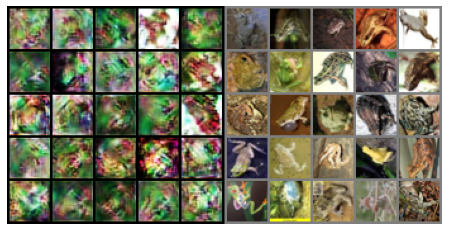

In [11]:
fig = plt.figure(figsize=(12,4))
plt.axis("off")  
pls = [[plt.imshow(norm_grid(im), animated=True)] for im in ims]
ani = animation.ArtistAnimation(fig, pls, interval=500, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

Well, these results are really poor. Mode collapse is more apparent here as well, but the fine structure of the frogs is also not quite what we wanted. Looking back through the iterations, there was some indication of more successful generations. Subjectively, the frogs started to show up, but then generation became slightly worse. We could run this code for many more iterations, and that might work in terms of getting the optimizers to create better distributions. But it is not guaranteed. 

Instead, now let's try using a Wasserstein GAN, where we use the gradient penalty as a method of making the discrminator 1-lipschitz (and therefore a valid critic to assess the earth mover distance). 

___
# Wasserstein GAN with Gradient Penalty
For this implementation, we need to add functionality to the gradient of the Discriminator to make it a critic. For the most part, we need to add the gradient loss function calculations to match the WGAN-GP.

In [ ]:
# class WGGenerator(nn.Module):

#     def __init__(self):
#         super(WGGenerator, self).__init__()

#         self.model = nn.Sequential(
#             nn.Linear(latent_dim, 128),
#             nn.LeakyReLU(0.2, inplace=True),
            
#             nn.Linear(128, 256),
#             nn.BatchNorm1d(256, 0.8),
#             nn.LeakyReLU(0.2, inplace=True),
            
#             nn.Linear(256, 512),
#             nn.BatchNorm1d(512, 0.8),
#             nn.LeakyReLU(0.2, inplace=True),
            
#             nn.Linear(512, 1024),
#             nn.BatchNorm1d(1024, 0.8),
#             nn.LeakyReLU(0.2, inplace=True),

#             nn.Linear(1024, int(np.prod(img_shape))),
#             nn.Tanh()
#         )

#     def forward(self, z):
#         img = self.model(z)
#         img = img.view(img.shape[0], *img_shape)
#         return img

In [ ]:
# class WGDiscriminator(nn.Module):

#     def __init__(self):
#         super(WGDiscriminator, self).__init__()

#         self.model = nn.Sequential(
#             nn.Linear(int(np.prod(img_shape)), 512),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Linear(512, 256),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Linear(256, 1),
#         )

#     def forward(self, img):
#         img_flat = img.view(img.shape[0], -1)
#         validity = self.model(img_flat)
#         return validity

In [8]:
class WGDiscriminator(nn.Module):

    def __init__(self):
        super(WGDiscriminator, self).__init__()

        self.model = nn.Sequential(
            nn.Conv2d(3, 16, 3, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            # dropout layer - important trick!
            nn.Dropout2d(0.25),

            nn.Conv2d(16, 32, 3, stride=2, padding=1),
            nn.LeakyReLU(0.3, inplace=True),
            nn.Dropout2d(0.25),
            nn.BatchNorm2d(32, 0.8),

            nn.Conv2d(32, 64, 3, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.25),
            nn.BatchNorm2d(64, 0.8),

            nn.Conv2d(64, 128, 3, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.25),
            nn.BatchNorm2d(128, 0.8),
        )

        # The height and width of downsampled image
        ds_size = width // 2 ** 4
        # Classification layer (just linear for the WGAN, critic)
        self.classification_layer = nn.Sequential(nn.Linear(128 * ds_size ** 2, 1))

    def forward(self, img):
        out = self.model(img)
        # use the view function to flatten the layer output
        #    old way for earlier Torch versions: out = out.view(out.shape[0], -1)
        out = torch.flatten(out, start_dim=1) # don't flatten over batch size
        validity = self.classification_layer(out)
        return validity

In [ ]:
# Initialize generator and discriminator
generator = Generator() # same generator, with new discriminator
discriminator = WGDiscriminator()

# RMSprop learning rate
lr = 0.0005
# number of training steps for discriminator per iter for WGANGP
n_critic = 5
# Loss weight for gradient penalty
lambda_gp = 10

# To stabilize training, we use learning rate decay
# and gradient clipping (by value) in the optimizer.
clip_value = 1

# Optimizers, no loss function defined here as
# will use torch.mean as loss function for WGAN.
# TODO: Use ADAM next time. 
discriminator_optimizer = torch.optim.RMSprop(discriminator.parameters(), lr=lr)
gan_optimizer = torch.optim.RMSprop(generator.parameters(), lr=lr)

This compute_gradient_penalty function for WGAN-GP comes from https://github.com/eriklindernoren/PyTorch-GAN/blob/master/implementations/wgan_gp/wgan_gp.py#L119.

In [ ]:
def compute_gradient_penalty(D, real_samples, fake_samples):
    """Calculates the gradient penalty loss for WGAN GP"""
    # Random weight term for interpolation between real and fake samples
    alpha = Tensor(np.random.random((real_samples.size(0), 1, 1, 1)))
    
    # Get random interpolation between real and fake samples
    interpolates = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)
    
    d_interpolates = D(interpolates)
    fake = Variable(Tensor(real_samples.shape[0], 1).fill_(1.0), requires_grad=False)
    
    # Get gradient w.r.t. interpolates
    gradients = torch.autograd.grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    
    gradients = gradients.view(gradients.size(0), -1)
    # use norm approx equal to one, as stated in paper. Rather than <1.
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty

In [ ]:
iterations = EPOCHS #defined above

# Sample random points in the latent space
plot_num_examples = 25
fixed_random_latent_vectors = torch.randn(plot_num_examples, latent_dim, device=device)
img_list = []
total_steps = 0

real_image_numpy = np.transpose(torchvision.utils.make_grid(real_image_examples[:plot_num_examples,:,:,:], padding=2, normalize=False, nrow=5),(0,1,2))



In [ ]:
# TODO: add code for loading from checkpoint so that 
#   we can continue a longer training run. 

for step in range(iterations):
    total_steps = total_steps+1

    for i, (imgs, _) in enumerate(dataloader):

        #===================================
        # DISCRIMINATOR OPTIMIZE AND GET LABELS

        # Zero out any previous calculated gradients
        discriminator_optimizer.zero_grad()

        # Combine real images with some generator images
        real_images = Variable(imgs.type(Tensor))
        
        # Sample random points in the latent space
        random_latent_vectors = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim))))
        
        # Decode them to fake images
        generated_images = generator(random_latent_vectors)
        
        # Compute gradient penalty
        gradient_penalty = compute_gradient_penalty(discriminator, real_images.data, generated_images.data)
        
        # Adversarial loss
        d_loss = -torch.mean(discriminator(real_images)) + \
                  torch.mean(discriminator(generated_images)) + \
                  lambda_gp * gradient_penalty

        # get gradients according to loss above
        d_loss.backward()
        # optimize the discriminator parameters to better classify images
        discriminator_optimizer.step()
        
        #===================================
        
        #===================================
        # GENERATOR OPTIMIZE AND GET LABELS
        
        # Zero out any previous calculated gradients
        gan_optimizer.zero_grad()

        # Train the generator for every n_critic iterations
        if i % n_critic == 0:
            # Decode them to fake images, through the generator
            generated_images = generator(random_latent_vectors)

            # Adversarial loss
            g_loss = -torch.mean(discriminator(generated_images))

            # now back propagate to get derivatives
            g_loss.backward()

            # use gan optimizer to only update the parameters of the generator
            # this was setup above to only use the params of generator
            gan_optimizer.step()
        
        
        
    # Occasionally save / plot
    if step % 10 == 0:
        # Print metrics
        print('Loss at step %s: D(z_c)=%s, D(G(z_mis))=%s' % (total_steps, d_loss.item(),g_loss.item()))
        # save images in a list for display later
        with torch.no_grad():
            fake_output = generator(fixed_random_latent_vectors).detach().cpu()
        img_list.append(torchvision.utils.make_grid(fake_output, padding=2, normalize=True, nrow=5))
        
        # in addition, save off a checkpoint of the current models and images
        ims = np.array([np.transpose(np.hstack((i,real_image_numpy)), (2,1,0)) for i in img_list])
        np.save('models/gan_models/wgan_images.npy',ims)

        # save the state of the models (will need to recreate upon reloading)
        torch.save({'state_dict': generator.state_dict()}, 'models/gan_models/wgan_gen.pth')
        torch.save({'state_dict': discriminator.state_dict()}, 'models/gan_models/wgan_dis.pth')
        

In [9]:
if True:
    ims = np.load('models/gan_models/wgan_images.npy')

    generator = Generator()
    discriminator = WGDiscriminator()

    checkpoint = torch.load('models/gan_models/wgan_gen.pth')
    generator.load_state_dict(checkpoint['state_dict'])

    checkpoint = torch.load('models/gan_models/wgan_dis.pth')
    discriminator.load_state_dict(checkpoint['state_dict'])

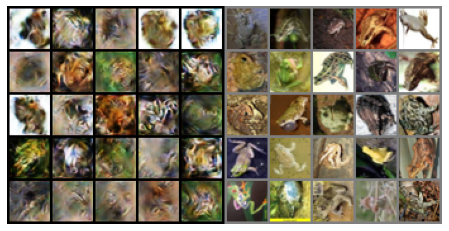

In [10]:
fig = plt.figure(figsize=(12,4))
plt.axis("off")  
pls = [[plt.imshow(norm_grid(im), animated=True)] for im in ims]
ani = animation.ArtistAnimation(fig, pls, interval=500, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())